In [7]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import folium


In [8]:
df = pd.read_csv('nuraghi.csv')

In [9]:
df.head(100)

,comune,provincia,nome,zona,locatita,sito_arche,categoria,identificatore,latitudine,longitudine,sup,alt_min,alt_max,alt_media,acqua,nuraghe_costiero,categ_acqua
0,ALGHERO,SASSARI,NaN,Nurra,NaN,Nuraghe,Nuraghe,NUR1000,40.640252,8.307970,225.3958,0,436,218.0,False,True,costa
1,ALGHERO,SASSARI,NaN,Nurra,NaN,Nuraghe,Nuraghe,NUR1001,40.641216,8.312872,225.3958,0,436,218.0,False,True,costa
2,ALGHERO,SASSARI,NaN,Nurra,NaN,Nuraghe,Nuraghe,NUR1002,40.651966,8.313069,225.3958,0,436,218.0,False,True,costa
3,ALGHERO,SASSARI,NaN,Nurra,NaN,Nuraghe,Nuraghe,NUR1003,40.649432,8.319236,225.3958,0,436,218.0,False,True,costa
4,ALGHERO,SASSARI,NaN,Nurra,NaN,Nuraghe,Nuraghe,NUR1005,40.643113,8.317458,225.3958,0,436,218.0,False,True,costa
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,ANELA,SASSARI,Nuraghe Sa Pruna,Goceano,NaN,Nuraghe,Nuraghe,NUR6383,40.476904,8.999238,36.8908,240,1158,699.0,True,False,fiume
96,ANELA,SASSARI,Nuraghe Siana,Goceano,NaN,Nuraghe,Nuraghe,NUR2971,40.427612,9.091862,36.8908,240,1158,699.0,True,False,fiume
97,ANELA,SASSARI,Nuraghe Siccadores,Goceano,NaN,Nuraghe,Nuraghe,NUR2620,40.481301,8.996915,36.8908,240,1158,699.0,True,False,fiume
98,ANELA,SASSARI,Nuraghe Sos Forrighesos,Goceano,NaN,Nuraghe,Nuraghe,NUR6434,40.475744,8.979006,36.8908,240,1158,699.0,True,False,fiume


In [10]:
df.shape

(7777, 17)

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7777 entries, 0 to 7776
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   comune            7777 non-null   object 
 1   provincia         7777 non-null   object 
 2   nome              6657 non-null   object 
 3   zona              7777 non-null   object 
 4   locatita          986 non-null    object 
 5   sito_arche        7777 non-null   object 
 6   categoria         7777 non-null   object 
 7   identificatore    7777 non-null   object 
 8   latitudine        7777 non-null   float64
 9   longitudine       7777 non-null   float64
 10  sup               7777 non-null   float64
 11  alt_min           7777 non-null   int64  
 12  alt_max           7777 non-null   int64  
 13  alt_media         7777 non-null   float64
 14  acqua             7777 non-null   bool   
 15  nuraghe_costiero  7777 non-null   bool   
 16  categ_acqua       4100 non-null   object 


In [12]:
df.describe()

,latitudine,longitudine,sup,alt_min,alt_max,alt_media
count,7777.000000,7777.000000,7777.000000,7777.000000,7777.000000,7777.000000
mean,40.054391,8.921715,94.989446,113.315289,694.639192,403.977241
std,0.546901,0.332388,91.588465,121.776363,319.941362,188.054348
min,38.883535,8.169072,2.474400,0.000000,13.000000,6.500000
25%,39.654413,8.666029,36.503400,0.000000,463.000000,248.500000
50%,40.146019,8.868105,67.376000,75.000000,676.000000,389.000000
75%,40.493285,9.140786,116.486000,175.000000,893.000000,519.500000
max,41.233560,9.823780,547.041800,660.000000,1830.000000,1193.000000


## EXPLORATORY DATA ANALISIS

#### We will use SQL to explore and understand the data. For this we will be using 'sqlite3' library.

In [13]:
import sqlite3
#And we create a connection to a database in the memory
conn = sqlite3.connect(':memory:')

In [14]:
#Load the DataFrame to the SQL database
df.to_sql('nuraghis', conn, index=False, if_exists='replace')



7777

### EXPLORATORY DATA ANALISIS

In [15]:
#General View of the Data
pd.read_sql('SELECT * FROM nuraghis LIMIT 5', conn)


,comune,provincia,nome,zona,locatita,sito_arche,categoria,identificatore,latitudine,longitudine,sup,alt_min,alt_max,alt_media,acqua,nuraghe_costiero,categ_acqua
0,ALGHERO,SASSARI,None,Nurra,None,Nuraghe,Nuraghe,NUR1000,40.640252,8.307970,225.3958,0,436,218.0,0,1,costa
1,ALGHERO,SASSARI,None,Nurra,None,Nuraghe,Nuraghe,NUR1001,40.641216,8.312872,225.3958,0,436,218.0,0,1,costa
2,ALGHERO,SASSARI,None,Nurra,None,Nuraghe,Nuraghe,NUR1002,40.651966,8.313069,225.3958,0,436,218.0,0,1,costa
3,ALGHERO,SASSARI,None,Nurra,None,Nuraghe,Nuraghe,NUR1003,40.649432,8.319236,225.3958,0,436,218.0,0,1,costa
4,ALGHERO,SASSARI,None,Nurra,None,Nuraghe,Nuraghe,NUR1005,40.643113,8.317458,225.3958,0,436,218.0,0,1,costa


In [16]:
#Counting and grouping different archaeological sites 
pd.read_sql('SELECT categoria, COUNT(*) as quantity FROM nuraghis GROUP BY categoria', conn)


,categoria,cantidad
0,Altri siti - Grotte Tafoni,18
1,Altri siti - Unicum,63
2,Culto dell'acqua,13
3,Culto dell'acqua - Fontana sacra,14
4,Culto dell'acqua - Pozzo sacro,51
5,Dolmen,69
6,Domus de janas,891
7,Menhir,108
8,Menhir antropomorfi,1
9,Menhir proto antropomorfi,1


In [19]:
#distribution of archeological sites by its province
pd.read_sql('SELECT provincia, COUNT(*) as quantity FROM nuraghis GROUP BY provincia ORDER BY quantity DESC', conn)


,provincia,quantity
0,SASSARI,2282
1,CAGLIARI,1470
2,ORISTANO,1467
3,NUORO,1152
4,CARBONIA IGLESIAS,484
5,OGLIASTRA,356
6,MEDIO CAPIDANO,337
7,OLBIA-TEMPIO,229


In [27]:
#Distribution of different types of nuraghi
query_nuraghi = """
SELECT categoria, COUNT(sito_arche) as num_nuraghes
FROM nuraghis
WHERE categoria IN ('Nuraghe semplice', 'Nuraghe complesso', 'Nuraghe a corridoio', 'Nuraghe')
GROUP BY categoria
"""
result_nuraghi = pd.read_sql(query_nuraghi, conn)
result_nuraghi

,categoria,num_nuraghes
0,Nuraghe,5566
1,Nuraghe a corridoio,40
2,Nuraghe complesso,230
3,Nuraghe semplice,278


In [29]:
#Distribution of archeological sites and their proximity to water
query_water = """SELECT categ_acqua, COUNT(*) as num_sites
FROM nuraghis
GROUP BY categ_acqua
ORDER BY num_sites DESC;
"""
result_water = pd.read_sql(query_water, conn)
result_water

,categ_acqua,num_sites
0,None,3677
1,fiume,1751
2,costa,1672
3,lago,677


## Geospatial Visualization

We will start the Geospatial Visualization by using Folium library to create a map that displays the archeological in Sardinia. The archeological sites will be concentrated in clusters that will display pop up markers as the user zoom in. In each of those pop up markers will appear a description when we click on them.

In [83]:
import folium
from folium.plugins import MarkerCluster

# Crear un mapa centrado en una latitud y longitud específica (ajústalo según tus necesidades)
m = folium.Map(location=[40, 9], zoom_start=7) # Usando coordenadas aproximadas de Cerdeña

# Crear un grupo de marcadores para agregar al mapa
marker_cluster = MarkerCluster().add_to(m)

# Definir un diccionario de colores para cada tipo de yacimiento
colores = {
    "Altri siti - Grotte Tafoni": "purple",
    "Altri siti - Unicum": "darkpurple",
    "Culto dell'acqua": "blue",
    "Culto dell'acqua - Fontana sacra": "lightblue",
    "Culto dell'acqua - Pozzo sacro": "darkblue",
    "Dolmen": "red",
    "Domus de janas": "green",
    "Menhir": "orange",
    "Menhir antropomorfi": "darkorange",
    "Menhir proto antropomorfi": "lightred",
    "Menhir statue": "pink",
    "Nuraghe": "cadetblue",
    "Nuraghe a corridoio": "darkred",
    "Nuraghe complesso": "darkgreen",
    "Nuraghe semplice": "lightgreen",
    "Tomba dei giganti - ciclopica": "beige",
    "Tomba dei giganti - dolmeica": "darkblue",
    "Tomba dei giganti - sepoltura a prospetto": "lightgray",
    "Tomba di giganti": "white",
    "Villaggio": "black",
    "Villaggio nurágico": "gray"
}

# Iterar sobre las filas del DataFrame y agregar un marcador para cada yacimiento
for idx, row in df.iterrows():
    popup_text = f"Sito Arqueológico: {row['sito_arche']}<br>Categoría: {row['categoria']}"
    folium.Marker(
        location=[row['latitudine'], row['longitudine']],
        popup=popup_text,
        icon=folium.Icon(color=colores.get(row['categoria'], 'gray'))
    ).add_to(marker_cluster)

m.save("mapa.html")
m

C:\Users\Albert\AppData\Local\Temp\ipykernel_22940\2449618612.py:41: UserWarning: color argument of Icon should be one of: {'darkred', 'gray', 'lightblue', 'green', 'darkpurple', 'pink', 'beige', 'orange', 'black', 'lightred', 'lightgreen', 'lightgray', 'blue', 'white', 'cadetblue', 'darkblue', 'darkgreen', 'red', 'purple'}.
  icon=folium.Icon(color=colores.get(row['categoria'], 'gray'))


Visualización por Categoría de Agua: Usar la columna "categ_acqua" para colorear los marcadores en función del tipo de agua cercano. Esto puede dar una idea visual de cómo se distribuyen los sitios en relación con las diferentes fuentes de agua.

In [35]:
import folium
from folium.plugins import MarkerCluster

# Crear un mapa centrado en una latitud y longitud específica
m = folium.Map(location=[40, 9], zoom_start=6)  # Coordenadas aproximadas de Cerdeña

# Crear un grupo de marcadores para agregar al mapa
marker_cluster = MarkerCluster().add_to(m)

# Definir un diccionario de colores para cada categoría de agua
colores_agua = {
    "costa": "blue",
    "fiume": "green",
    "lago": "purple",
    "NaN": "gray"  # Para aquellos sin información de agua
}

# Iterar sobre las filas del DataFrame y agregar un marcador para cada yacimiento
for idx, row in df.iterrows():
    color_actual = colores_agua.get(row['categ_acqua'], 'gray')  # Default es gris si no se encuentra
    folium.Marker(
        location=[row['latitudine'], row['longitudine']],
        popup=row['sito_arche'] + " - " + str(row['categ_acqua']),  # Mostrará el nombre del sitio y el tipo de agua
        icon=folium.Icon(color=color_actual)
    ).add_to(marker_cluster)

m.save("mapa_agua.html")
m


### GENERAL HEATMAP
A continuación emplearemos un mapa de calor para regular y relativizar la densidad de los sitios arqueológicos de la isla.

In [82]:
from folium.plugins import HeatMap

m = folium.Map(location=[40, 9], zoom_start=7)

data = [[row['latitudine'], row['longitudine']] for idx, row in df.iterrows()]

# Ajustar estos valores según tus necesidades
radius = 15  # Ajusta el radio de influencia de cada punto
max_val = 1.0  # Valor máximo para colorear
min_opacity = 0.1  # Ajusta la opacidad mínima

HeatMap(data, radius=radius, max_val=max_val, min_opacity=min_opacity).add_to(m)

m.save("adjusted_heatmap.html")
m



C:\Users\Albert\AppData\Local\Temp\ipykernel_22940\4138238794.py:12: UserWarning: The `max_val` parameter is no longer necessary. The largest intensity is calculated automatically.
  HeatMap(data, radius=radius, max_val=max_val, min_opacity=min_opacity).add_to(m)


### NURAGHI HEATMAP

In [81]:

m = folium.Map(location=[40, 9], zoom_start=7)

# Filtra el DataFrame para considerar solo las filas donde la categoría es 'Nuraghe'
nuraghe_data = df[df['categoria'] == 'Nuraghe']

data = [[row['latitudine'], row['longitudine']] for idx, row in nuraghe_data.iterrows()]

# Ajustar estos valores según tus necesidades
radius = 15  # Ajusta el radio de influencia de cada punto
max_val = 1.0  # Valor máximo para colorear
min_opacity = 0.1  # Ajusta la opacidad mínima

HeatMap(data, radius=radius, max_val=max_val, min_opacity=min_opacity).add_to(m)

m.save("nuraghe_heatmap.html")
m

C:\Users\Albert\AppData\Local\Temp\ipykernel_22940\973366374.py:13: UserWarning: The `max_val` parameter is no longer necessary. The largest intensity is calculated automatically.
  HeatMap(data, radius=radius, max_val=max_val, min_opacity=min_opacity).add_to(m)


### OTHER ARCHEOLOGICAL SITES HEATMAP

In [80]:
from folium.plugins import HeatMap

m = folium.Map(location=[40, 9], zoom_start=7)

# Filtra el DataFrame para excluir las filas donde la categoría es 'Nuraghe'
non_nuraghe_data = df[df['categoria'] != 'Nuraghe']

data = [[row['latitudine'], row['longitudine']] for idx, row in non_nuraghe_data.iterrows()]

# Ajustar estos valores según tus necesidades
radius = 15  # Ajusta el radio de influencia de cada punto
max_val = 1.0  # Valor máximo para colorear
min_opacity = 0.1  # Ajusta la opacidad mínima

HeatMap(data, radius=radius, max_val=max_val, min_opacity=min_opacity).add_to(m)

m.save("non_nuraghe_heatmap.html")
m


C:\Users\Albert\AppData\Local\Temp\ipykernel_22940\999450199.py:15: UserWarning: The `max_val` parameter is no longer necessary. The largest intensity is calculated automatically.
  HeatMap(data, radius=radius, max_val=max_val, min_opacity=min_opacity).add_to(m)


Análisis de Distribución: Podemos calcular qué porcentaje de los sitios están cerca de cada tipo de agua (costa, fiume, lago) y cuántos no tienen una fuente de agua registrada (NaN).

In [36]:
# Contar el número de sitios para cada tipo de agua
distribucion_agua = df['categ_acqua'].value_counts()

# Calcular los porcentajes
porcentaje_agua = (distribucion_agua / len(df)) * 100

print(porcentaje_agua)


categ_acqua
fiume    22.515109
costa    21.499293
lago      8.705156
Name: count, dtype: float64


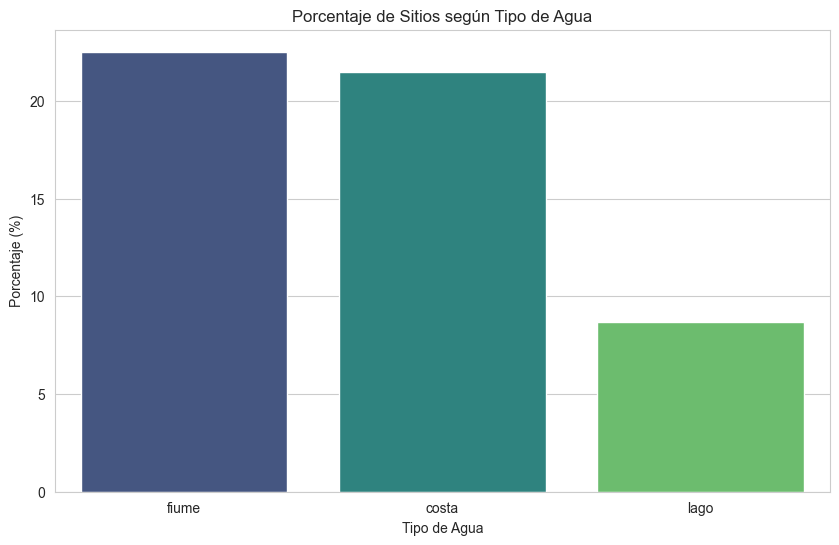

In [37]:
import matplotlib.pyplot as plt
import seaborn as sns

# Establecer el estilo visual
sns.set_style("whitegrid")

# Crear un gráfico de barras con los porcentajes
plt.figure(figsize=(10, 6))
sns.barplot(x=porcentaje_agua.index, y=porcentaje_agua.values, palette="viridis")
plt.title("Porcentaje de Sitios según Tipo de Agua")
plt.ylabel("Porcentaje (%)")
plt.xlabel("Tipo de Agua")
plt.show()


Combinar con la Altitud: Puedes también considerar combinar la proximidad al agua con la altitud para ver si hay alguna relación o patrón. Por ejemplo, ¿los sitios más altos tienden a estar cerca de lagos o ríos?

1. Gráfico de dispersión de altitud frente a categoría de agua:
Esta visualización nos permitirá ver cómo se distribuyen las altitudes para cada tipo de fuente de agua.

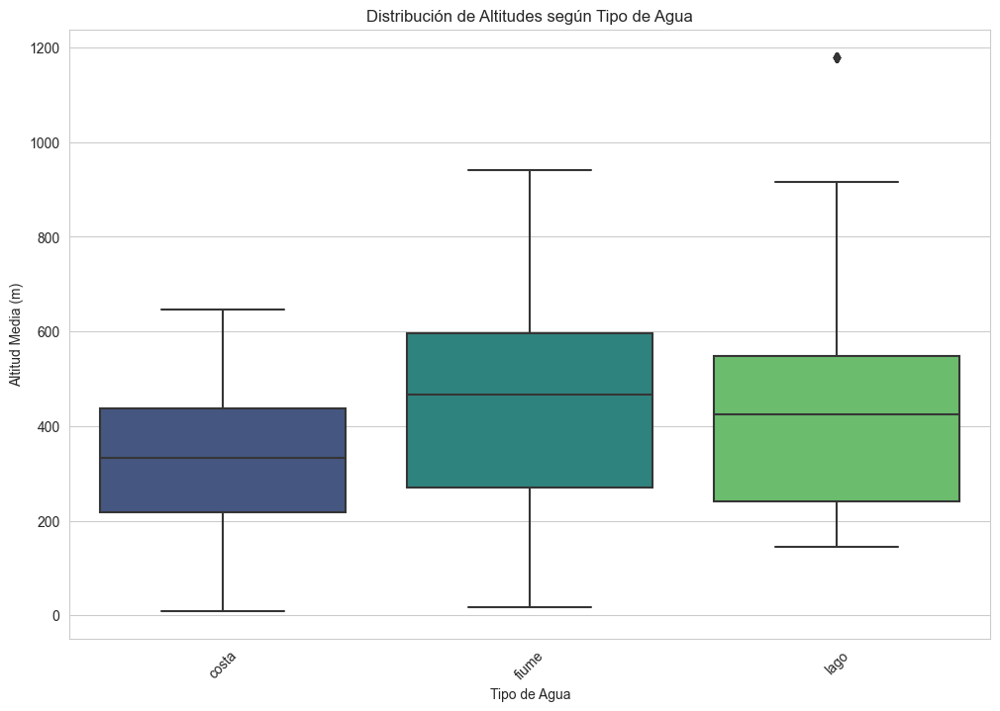

In [38]:
import matplotlib.pyplot as plt
import seaborn as sns

# Establecer el estilo visual
sns.set_style("whitegrid")

# Crear un gráfico de dispersión de altitud vs tipo de agua
plt.figure(figsize=(12, 8))
sns.boxplot(x=df['categ_acqua'], y=df['alt_media'], palette="viridis")
plt.title("Distribución de Altitudes según Tipo de Agua")
plt.ylabel("Altitud Media (m)")
plt.xlabel("Tipo de Agua")
plt.xticks(rotation=45)
plt.show()


In [40]:
# Calculando estadísticas descriptivas para la altitud según el tipo de agua
estadisticas_altitud = df.groupby('categ_acqua')['alt_media'].describe()
estadisticas_altitud


,count,mean,std,min,25%,50%,75%,max
categ_acqua,,,,,,,,
costa,1672.0,324.185706,148.758600,9.5,218.0,333.0,437.5,646.5
fiume,1751.0,437.014563,205.196979,16.5,269.5,465.5,596.5,941.5
lago,677.0,469.892910,268.875771,144.0,240.0,424.5,547.0,1179.5


A partir de los resultados que has proporcionado, aquí hay algunas observaciones e inferencias que podemos hacer:

1. Cantidad de sitios por categoría de agua:

    Costa: 1,672 sitios

    Fiume (río): 1,751 sitios

    Lago (lago): 677 sitios

Esto indica que hay más sitios arqueológicos cerca de la costa y los ríos que cerca de los lagos.

2. Media de la altitud:

    Costa: 324.19 m

    Fiume: 437.01 m

    Lago: 469.89 m

Esto sugiere que, en promedio, los sitios cerca de los lagos están a una altitud más alta que los sitios cerca de ríos o la costa.

3. Desviación estándar:
La desviación estándar mide la dispersión de un conjunto de datos. Una desviación estándar más alta indica una mayor variabilidad en los datos.

    Costa: 148.76 m

    Fiume: 205.20 m

    Lago: 268.88 m

Esto sugiere que la altitud de los sitios cerca de los lagos varía mucho más que la de los sitios cerca de ríos o la costa.

4. Altitud mediana:

    Costa: 333 m

    Fiume: 465.5 m

    Lago: 424.5 m

La mediana nos indica el valor central de un conjunto de datos. Aunque los sitios cerca de los lagos tienen la altitud media más alta, su mediana es menor que la de los sitios cerca de ríos.

5. Rango intercuartil (IQR):
El rango intercuartil (entre el 25% y el 75%) nos da una idea de la distribución central de los datos y es menos susceptible a valores atípicos.

    Costa: Entre 218 m y 437.5 m

    Fiume: Entre 269.5 m y 596.5 m

    Lago: Entre 240 m y 547 m

Esto refuerza la idea de que los sitios cerca de ríos y lagos tienden a estar a mayores altitudes que los cerca de la costa.

6. Valores extremos:
Los sitios cerca de los lagos tienen la mayor altitud máxima (1,179.5 m), mientras que los de la costa tienen la menor altitud mínima (9.5 m).

### Inferencias:

Hay una tendencia clara de que los sitios arqueológicos cerca de lagos y ríos se encuentran a altitudes más altas en comparación con aquellos cerca de la costa.
Los sitios cerca de lagos tienen una variabilidad significativamente mayor en términos de altitud en comparación con ríos y costas, lo que podría sugerir que los lagos en la región están distribuidos en una variedad de altitudes.
Aunque los sitios cerca de ríos tienen una mediana de altitud más alta que los sitios cerca de lagos, los lagos tienen una media más alta y una mayor variabilidad, lo que podría indicar la presencia de algunos sitios muy altos cerca de lagos que elevan la media.
Estas inferencias proporcionan una comprensión inicial de la relación entre la altitud y la proximidad al agua en los sitios arqueológicos de tu dataset.







## CORRELATION STUDY

### 1. Relación entre la ubicación de los Nurgahi y la proximidad al agua:

In [43]:
nuraghes_por_agua = df[df['categoria'].str.contains("Nuraghe")]['categ_acqua'].value_counts(dropna=False)
nuraghes_por_agua


categ_acqua
NaN      2906
costa    1359
fiume    1346
lago      503
Name: count, dtype: int64

#### Análisis de salinidad:
Para el análisis de salinidad (agua salada vs agua dulce):

Costa: representa agua salada.
Fiume y Lago: representan agua dulce.
Puedes hacer una agregación simple para obtener la cantidad de nuraghes cerca de agua salada y dulce:

In [42]:
agua_salada = nuraghes_por_agua.get('costa', 0)
agua_dulce = nuraghes_por_agua.get('fiume', 0) + nuraghes_por_agua.get('lago', 0)

print(f"Nuraghes cerca de agua salada: {agua_salada}")
print(f"Nuraghes cerca de agua dulce: {agua_dulce}")


Nuraghes cerca de agua salada: 1359
Nuraghes cerca de agua dulce: 1849


### 2. Relación entre la altitud del municipio y la cantidad o tipo de sitios arqueológicos:

Agrupación por Altitud y Tipo de Sitio:

In [44]:
# Agrupamos por altitud media y categoría, y contamos la cantidad de sitios
agrupado_altitud = df.groupby(['alt_media', 'categoria']).size().reset_index(name='cantidad')


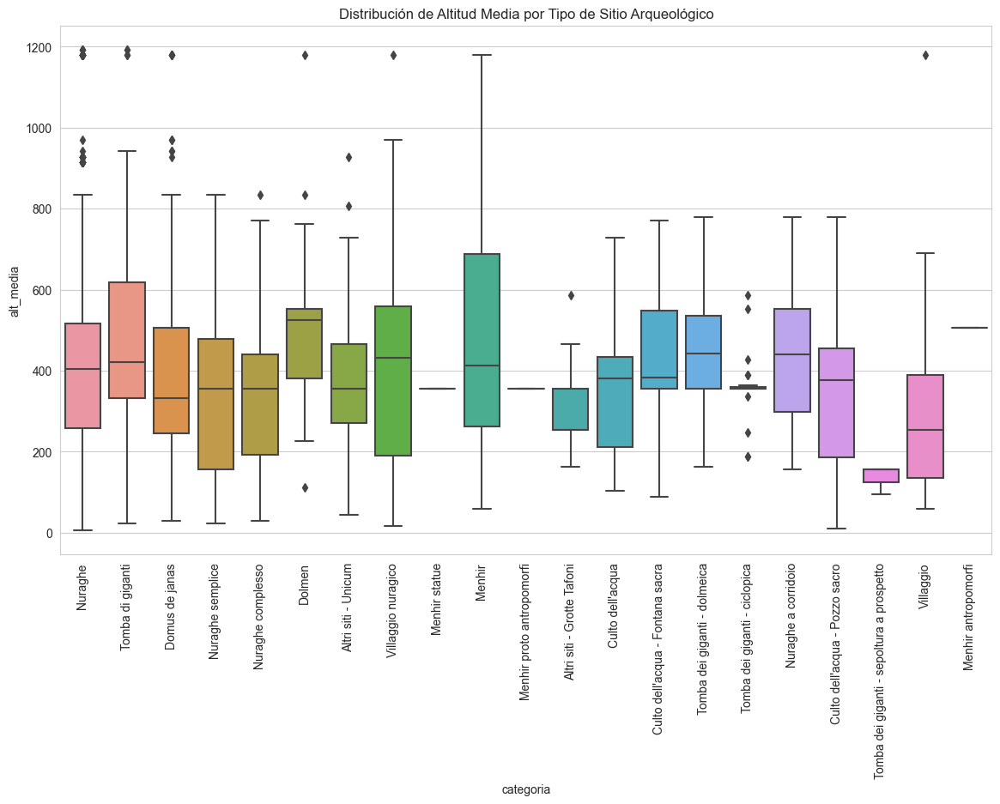

In [47]:
plt.figure(figsize=(14, 8))
sns.boxplot(data=df, x='categoria', y='alt_media')
plt.xticks(rotation=90)  # Rotar las etiquetas para mejor visualización
plt.title('Distribución de Altitud Media por Tipo de Sitio Arqueológico')
plt.show()


### Correlación entre Altitud y Cantidad/Tipos de Sitios:

In [57]:
correlacion_tipo_sitio = df.groupby('provincia')['alt_media'].mean().corr(df.groupby('provincia')['categoria'].count())
correlacion_tipo_sitio


-0.05939633497760686

Este valor indica una correlación negativa muy débil entre la altitud y la cantidad/tipo de sitios arqueológicos. En otras palabras, hay una ligera tendencia de que a mayor altitud, haya menos sitios arqueológicos (o un tipo específico de sitio), pero al igual que con la primera correlación, la relación es tan débil que no se puede concluir que haya una relación directa entre estas dos variables en el conjunto de datos.

### Correlación entre Sitio Arqueológicos y Proximidad al Agua:
Puede ser interesante ver si ciertos tipos de sitios tienen una mayor tendencia a estar cerca de ciertas fuentes de agua.

In [59]:
import pandas as pd

# Codificación
tipo_sitio_map = {
    "Altri siti - Grotte Tafoni": 1,
    "Altri siti - Unicum": 2,
    "Culto dell'acqua": 3,
    "Culto dell'acqua - Fontana sacra": 4,
    "Culto dell'acqua - Pozzo sacro": 5,
    "Dolmen": 6,
    "Domus de janas": 7,
    "Menhir": 8,
    "Menhir antropomorfi": 9,
    "Menhir proto antropomorfi": 10,
    "Menhir statue": 11,
    "Nuraghe": 12,
    "Nuraghe a corridoio": 13,
    "Nuraghe complesso": 14,
    "Nuraghe semplice": 15,
    "Tomba dei giganti - ciclopica": 16,
    "Tomba dei giganti - dolmeica": 17,
    "Tomba dei giganti - sepoltura a prospetto": 18,
    "Tomba di giganti": 19,
    "Villaggio": 20,
    "Villaggio nurágico": 21
}

proximidad_agua_map = {
    "costa": 1,
    "fiume": 2,
    "lago": 3,
    "NaN": 0
}

df['tipo_sitio_codificado'] = df['sito_arche'].map(tipo_sitio_map)
df['proximidad_agua_codificado'] = df['categ_acqua'].map(proximidad_agua_map)

# Cálculo de la correlación
correlacion = df['tipo_sitio_codificado'].corr(df['proximidad_agua_codificado'])
print(correlacion)


-0.08514876928177025


El resultado obtenido de −0.08514876928177025 indica una correlación negativa muy débil entre los tipos de sitios y su proximidad al agua.

### CONCLUSIÓN DEL ESTUDIO DE CORRELACIÓN
El dataset que tenemos no contiene los suficientes datos como para establecer algún tipo de correlación entre ellos. Sería interesante que el Dataset fuese ampliado en un futuro con información nueva y relevante como la cronología aproximada de cada yacimiento, el tamaño (área) de cada yacimiento, el tipo de cultura a la que pertenece cada yacimiento, las características geográficas del municipio y/o provincia (vegetación, calidad del suelo, etc.).